In [1]:
import pandas as pd
import requests
import lxml
from IPython.display import Image

In [2]:
url='https://www.pagina12.com.ar/'

In [3]:
p12=requests.get(url) ## aca se descargo la url

In [4]:
p12.status_code #si el status code me da 200 la pagina se cargo bien 

200

In [5]:
print(p12.text) ## este nes el archivo de texto plano de la pagina web

<!DOCTYPE html><html class="no-js"><head><meta charset="utf-8"><title>Página12 | La otra mirada</title><meta name="google-site-verification" content="x6zSdT0DBcKDmridH4LpEVrCmxcOunR2dgBQVmuL6fg"><script type="application/ld+json">{"@context": "http://schema.org","@type": "Organization","name": "Página12","url": "https://www.pagina12.com.ar","logo": {"@type": "ImageObject","url": "https://www.pagina12.com.ar/assets/media/logo_default_p12.png","width": "600","height": "60"},"sameAs":["https://twitter.com/pagina12","https://www.youtube.com/channel/UCJNDedOnljCssaiRZqg8-Dg","https://www.instagram.com/pagina12/","https://www.facebook.com/Pagina12ok/"]}</script><meta property="description" name="description" content="Notas focalizadas en el quehacer político de la Argentina."><meta property="fb:pages" name="fb:pages" content="1541638399393436"><meta property="og:locale" name="og:locale" content="es_AR"><meta property="og:title" name="og:title" content="Página12 | La otra mirada"><meta proper

In [6]:
p12.content

b'<!DOCTYPE html><html class="no-js"><head><meta charset="utf-8"><title>P\xc3\xa1gina12 | La otra mirada</title><meta name="google-site-verification" content="x6zSdT0DBcKDmridH4LpEVrCmxcOunR2dgBQVmuL6fg"><script type="application/ld+json">{"@context": "http://schema.org","@type": "Organization","name": "P\xc3\xa1gina12","url": "https://www.pagina12.com.ar","logo": {"@type": "ImageObject","url": "https://www.pagina12.com.ar/assets/media/logo_default_p12.png","width": "600","height": "60"},"sameAs":["https://twitter.com/pagina12","https://www.youtube.com/channel/UCJNDedOnljCssaiRZqg8-Dg","https://www.instagram.com/pagina12/","https://www.facebook.com/Pagina12ok/"]}</script><meta property="description" name="description" content="Notas focalizadas en el quehacer pol\xc3\xadtico de la Argentina."><meta property="fb:pages" name="fb:pages" content="1541638399393436"><meta property="og:locale" name="og:locale" content="es_AR"><meta property="og:title" name="og:title" content="P\xc3\xa1gina12 

In [7]:
p12.headers ##encabezado

{'Date': 'Sat, 12 Feb 2022 03:59:29 GMT', 'Content-Type': 'text/html; charset=utf-8', 'Transfer-Encoding': 'chunked', 'Connection': 'keep-alive', 'vary': 'Accept-Encoding', 'x-dns-prefetch-control': 'off', 'strict-transport-security': 'max-age=15724800; includeSubDomains', 'x-download-options': 'noopen', 'x-content-type-options': 'nosniff', 'x-xss-protection': '1; mode=block', 'x-etag': 'W/"5f986-xoAJWTKujiA3U7xnFEnP0560uqs"', 'x-backend': 'frontend', 'x-type': 'Dynamic URI', 'x-backend-ttl': '120.000', 'age': '28', 'grace': '86400.000 none', 'ttl': '91.511', 'x-instance': 'cache-front-prod-varnish-68cf7d4bd6-mlrz9', 'x-restarts': '0', 'x-cache': 'hit cached', 'CF-Cache-Status': 'DYNAMIC', 'Expect-CT': 'max-age=604800, report-uri="https://report-uri.cloudflare.com/cdn-cgi/beacon/expect-ct"', 'Server': 'cloudflare', 'CF-RAY': '6dc2e791a93b3edc-BOG', 'Content-Encoding': 'gzip'}

In [8]:
p12.request.headers

{'User-Agent': 'python-requests/2.25.1', 'Accept-Encoding': 'gzip, deflate', 'Accept': '*/*', 'Connection': 'keep-alive'}

In [9]:
p12.request.method ## ver que metodo se esta utilizando para hacer una solicitud

'GET'

In [10]:
p12.request.url

'https://www.pagina12.com.ar/'

In [11]:
##clase 5/30  Parseando html con beautiful soup
from bs4 import BeautifulSoup

In [12]:
s=BeautifulSoup(p12.text,'html.parser')

In [13]:
type(s)

bs4.BeautifulSoup

In [14]:
print(s.prettify()) ## para ver la estructura jerarquica

<!DOCTYPE html>
<html class="no-js">
 <head>
  <meta charset="utf-8"/>
  <title>
   Página12 | La otra mirada
  </title>
  <meta content="x6zSdT0DBcKDmridH4LpEVrCmxcOunR2dgBQVmuL6fg" name="google-site-verification"/>
  <script type="application/ld+json">
   {"@context": "http://schema.org","@type": "Organization","name": "Página12","url": "https://www.pagina12.com.ar","logo": {"@type": "ImageObject","url": "https://www.pagina12.com.ar/assets/media/logo_default_p12.png","width": "600","height": "60"},"sameAs":["https://twitter.com/pagina12","https://www.youtube.com/channel/UCJNDedOnljCssaiRZqg8-Dg","https://www.instagram.com/pagina12/","https://www.facebook.com/Pagina12ok/"]}
  </script>
  <meta content="Notas focalizadas en el quehacer político de la Argentina." name="description" property="description"/>
  <meta content="1541638399393436" name="fb:pages" property="fb:pages"/>
  <meta content="es_AR" name="og:locale" property="og:locale"/>
  <meta content="Página12 | La otra mirada" na

In [15]:
#Clase 6/30
#con esto extraigo los items de la barra de secciones en una lista:
secciones=s.find('ul',attrs={'class':'horizontal-list main-sections hide-on-dropdown'}).find_all('li')
secciones

[<li class="p12-separator--right--primary"><a href="https://www.pagina12.com.ar/secciones/el-pais">El país</a></li>,
 <li class="p12-separator--right--primary"><a href="https://www.pagina12.com.ar/secciones/economia">Economía</a></li>,
 <li class="p12-separator--right--primary"><a href="https://www.pagina12.com.ar/secciones/sociedad">Sociedad</a></li>,
 <li class="no-separator-on-1040 p12-separator--right--primary"><a href="https://www.pagina12.com.ar/suplementos/cultura-y-espectaculos">Cultura y Espectáculos</a></li>,
 <li class="hide-on-1040 p12-separator--right--primary"><a href="https://www.pagina12.com.ar/secciones/deportes">Deportes</a></li>,
 <li class="hide-on-1040 p12-separator--right--primary"><a href="https://www.pagina12.com.ar/secciones/el-mundo">El mundo</a></li>,
 <li class="hide-on-1040"><a href="https://www.pagina12.com.ar/secciones/contratapa">Contratapa</a></li>]

In [16]:
    #tomo el primer elemento
    seccion = secciones[0]

In [17]:
seccion.a #abreviatura para el metodo find

<a href="https://www.pagina12.com.ar/secciones/el-pais">El país</a>

In [18]:
seccion.a.get_text()

'El país'

In [19]:
seccion.a.get('href')

'https://www.pagina12.com.ar/secciones/el-pais'

In [20]:
links_secciones=[s.a.get('href') for s in secciones]
links_secciones

['https://www.pagina12.com.ar/secciones/el-pais',
 'https://www.pagina12.com.ar/secciones/economia',
 'https://www.pagina12.com.ar/secciones/sociedad',
 'https://www.pagina12.com.ar/suplementos/cultura-y-espectaculos',
 'https://www.pagina12.com.ar/secciones/deportes',
 'https://www.pagina12.com.ar/secciones/el-mundo',
 'https://www.pagina12.com.ar/secciones/contratapa']

In [21]:
seccion_el_pais=requests.get(links_secciones[0])

In [22]:
seccion_el_pais

<Response [200]>

In [23]:
soup_seccion_pais=BeautifulSoup(seccion_el_pais.text,'html.parser') #convierto la seccion a beautifulsoup
soup_seccion_pais

<!DOCTYPE html>
<html amp="" lang="es"><head><meta charset="utf-8"/><title>El país | Página12</title><!-- DUST PATH: /usr/src/app/src/widgets/fc_jsonLD.dust/ --><script type="application/ld+json">{"@context": "http://schema.org","@type": "Organization","name": "Página12","url": "https://www.pagina12.com.ar","logo": {"@type": "ImageObject","url": "https://www.pagina12.com.ar/assets/media/logo_default_p12.png","width": "600","height": "60"},"sameAs":["https://twitter.com/pagina12","https://www.youtube.com/channel/UCJNDedOnljCssaiRZqg8-Dg","https://www.instagram.com/pagina12/","https://www.facebook.com/Pagina12ok/"]}</script><script type="application/ld+json">{"@context": "http://schema.org","@type": "NewsArticle","mainEntityOfPage": {"@type": "WebPage","@id": "https://www.pagina12.com.ar/secciones/el-pais"},"headline": "El país | Página12","isAccessibleForFree": "False","image": {"@type": "ImageObject","url": "https://www.pagina12.com.ar/assets/media/logo_default_p12.png","width": "600",

In [24]:
print(soup_seccion_pais.prettify())

<!DOCTYPE html>
<html amp="" lang="es">
 <head>
  <meta charset="utf-8"/>
  <title>
   El país | Página12
  </title>
  <!-- DUST PATH: /usr/src/app/src/widgets/fc_jsonLD.dust/ -->
  <script type="application/ld+json">
   {"@context": "http://schema.org","@type": "Organization","name": "Página12","url": "https://www.pagina12.com.ar","logo": {"@type": "ImageObject","url": "https://www.pagina12.com.ar/assets/media/logo_default_p12.png","width": "600","height": "60"},"sameAs":["https://twitter.com/pagina12","https://www.youtube.com/channel/UCJNDedOnljCssaiRZqg8-Dg","https://www.instagram.com/pagina12/","https://www.facebook.com/Pagina12ok/"]}
  </script>
  <script type="application/ld+json">
   {"@context": "http://schema.org","@type": "NewsArticle","mainEntityOfPage": {"@type": "WebPage","@id": "https://www.pagina12.com.ar/secciones/el-pais"},"headline": "El país | Página12","isAccessibleForFree": "False","image": {"@type": "ImageObject","url": "https://www.pagina12.com.ar/assets/media/lo

In [25]:
articulo_promocionado=soup_seccion_pais.find('h2',attrs={'class':'title-list'})
articulo_promocionado

<h2 class="title-list"><a href="/401205-rechazan-las-recusaciones-de-cfk">Rechazan las recusaciones de CFK</a></h2>

In [26]:
#Articulo_promocionado.a.get('href')
link_articulo_promocionado = [articulo_promocionado.a.get('href')]
link_articulo_promocionado 

['/401205-rechazan-las-recusaciones-de-cfk']

In [27]:
lista_articulos_exaltados=soup_seccion_pais.find_all('h3',attrs={'class':'title-list'})
lista_articulos_exaltados


[<h3 class="title-list"><a href="/401181-gestapo-macrista-piden-la-ampliacion-de-la-imputacion-a-macr">"Gestapo" macrista: Piden la ampliación de la imputación a Macri y que citen a indagatoria a Vidal</a></h3>,
 <h3 class="title-list"><a href="/401206-la-gestapo-macrista-y-la-persecucion-a-jueces">La "Gestapo" macrista y la persecución a jueces</a></h3>]

In [28]:
links_articulos_exaltados = [link.a.get('href') for link in lista_articulos_exaltados]
links_articulos_exaltados

['/401181-gestapo-macrista-piden-la-ampliacion-de-la-imputacion-a-macr',
 '/401206-la-gestapo-macrista-y-la-persecucion-a-jueces']

In [29]:
lista_demas_articulos=soup_seccion_pais.find_all('h4',attrs={'class':'is-display-inline title-list'})
lista_demas_articulos


[<h4 class="is-display-inline title-list"><a class="" href="/401180-los-intendentes-del-pro-tambien-piden-apoyar-el-acuerdo-con-">Los intendentes del PRO también piden apoyar el acuerdo con el FMI</a></h4>,
 <h4 class="is-display-inline title-list"><a class="" href="/401182-juicio-politico">Juicio Político</a></h4>,
 <h4 class="is-display-inline title-list"><a class="" href="/401183-gobernadores-del-norte-manifestaron-su-apoyo-al-traspaso-de-">Gobernadores del Norte manifestaron su apoyo al traspaso de colectivos a la Ciudad de Buenos Aires</a></h4>,
 <h4 class="is-display-inline title-list"><a class="" href="/401184-colectivos-portenos-a-rodriguez-larreta-lo-dejaron-solo">Colectivos porteños: A Rodríguez Larreta lo dejaron solo</a></h4>,
 <h4 class="is-display-inline title-list"><a class="" href="/401189-alberto-fernandez-queremos-poner-en-valor-el-aporte-de-la-mu">Alberto Fernández: “Queremos poner en valor el aporte de la mujer para el desarrollo de nuestra sociedad”</a></h4>,
 <h4 

In [30]:
links_demas_articulos= [link.a.get('href') for link in lista_demas_articulos]
links_demas_articulos

['/401180-los-intendentes-del-pro-tambien-piden-apoyar-el-acuerdo-con-',
 '/401182-juicio-politico',
 '/401183-gobernadores-del-norte-manifestaron-su-apoyo-al-traspaso-de-',
 '/401184-colectivos-portenos-a-rodriguez-larreta-lo-dejaron-solo',
 '/401189-alberto-fernandez-queremos-poner-en-valor-el-aporte-de-la-mu',
 '/401190-la-cidh-rechazo-pedidos-de-impugnacion-de-cinco-represores',
 '/401196-el-gobierno-lanza-un-instructivo-para-fomentar-la-equidad-de',
 '/401204-continua-la-busqueda-de-consensos']

In [31]:
def obtener_links(soup_seccion_pais):
    lista_links=[]
  
    articulo_promocionado = soup_seccion_pais.find('h2', attrs={'class': 'title-list'})
    if articulo_promocionado:
        lista_links.append(articulo_promocionado.a.get('href'))
   
    lista_articulos_exaltados = soup_seccion_pais.find_all('h3', attrs={'class': 'title-list'})
    if lista_articulos_exaltados:
        for link in lista_articulos_exaltados: 
            lista_links.append(link.a.get('href'))
    
    lista_demas_articulos = soup_seccion_pais.find_all('h4',attrs={'class':'is-display-inline title-list'})
    if lista_demas_articulos:   
        for link in lista_demas_articulos: 
            lista_links.append(link.a.get('href'))
    
    
    return lista_links

In [32]:
lista_links= obtener_links(soup_seccion_pais)
lista_links

['/401205-rechazan-las-recusaciones-de-cfk',
 '/401181-gestapo-macrista-piden-la-ampliacion-de-la-imputacion-a-macr',
 '/401206-la-gestapo-macrista-y-la-persecucion-a-jueces',
 '/401180-los-intendentes-del-pro-tambien-piden-apoyar-el-acuerdo-con-',
 '/401182-juicio-politico',
 '/401183-gobernadores-del-norte-manifestaron-su-apoyo-al-traspaso-de-',
 '/401184-colectivos-portenos-a-rodriguez-larreta-lo-dejaron-solo',
 '/401189-alberto-fernandez-queremos-poner-en-valor-el-aporte-de-la-mu',
 '/401190-la-cidh-rechazo-pedidos-de-impugnacion-de-cinco-represores',
 '/401196-el-gobierno-lanza-un-instructivo-para-fomentar-la-equidad-de',
 '/401204-continua-la-busqueda-de-consensos']

In [33]:
def lista_de_links_utiles(lista):
    
    lista_de_links_utiles=[]

    for i in range(0,len(lista)):
        lista_de_links_utiles.append('https://www.pagina12.com.ar'+lista[i])
    
    return lista_de_links_utiles

In [34]:
lista_de_links_utiles(lista_links)

['https://www.pagina12.com.ar/401205-rechazan-las-recusaciones-de-cfk',
 'https://www.pagina12.com.ar/401181-gestapo-macrista-piden-la-ampliacion-de-la-imputacion-a-macr',
 'https://www.pagina12.com.ar/401206-la-gestapo-macrista-y-la-persecucion-a-jueces',
 'https://www.pagina12.com.ar/401180-los-intendentes-del-pro-tambien-piden-apoyar-el-acuerdo-con-',
 'https://www.pagina12.com.ar/401182-juicio-politico',
 'https://www.pagina12.com.ar/401183-gobernadores-del-norte-manifestaron-su-apoyo-al-traspaso-de-',
 'https://www.pagina12.com.ar/401184-colectivos-portenos-a-rodriguez-larreta-lo-dejaron-solo',
 'https://www.pagina12.com.ar/401189-alberto-fernandez-queremos-poner-en-valor-el-aporte-de-la-mu',
 'https://www.pagina12.com.ar/401190-la-cidh-rechazo-pedidos-de-impugnacion-de-cinco-represores',
 'https://www.pagina12.com.ar/401196-el-gobierno-lanza-un-instructivo-para-fomentar-la-equidad-de',
 'https://www.pagina12.com.ar/401204-continua-la-busqueda-de-consensos']

In [35]:
##clase7/30 Manejo de errores , ver de nuevo para hacer un proyecto real y mas robusto

In [36]:
##Clase 8/30 Descargando contenido (titulo,contenido,etc)

In [37]:
url_noticias=lista_de_links_utiles(lista_links)
url_noticia_a_scrapear=url_noticias[0]

In [38]:
try:
    primer_articulo=requests.get(url_noticia_a_scrapear)
    if primer_articulo.status_code == 200:
        soup_primer_articulo=BeautifulSoup(primer_articulo.text,'html.parser')
        ##Extraer Titulo
        titulo=soup_primer_articulo.find('div',attrs={'class':'col 2-col'}).find('h1')
        
        ##Extraer Fecha
        fecha=soup_primer_articulo.find('div',attrs={'class':'date modification-date'}).find('time').get('datetime')
        
        ##Extraer copete
        copete=soup_primer_articulo.find('div',attrs={'class':'col 2-col'}).find('h3')
        
        ##Extraer Volanta
        Volanta=soup_primer_articulo.find('div',attrs={'class':'col 2-col'}).find('h4')
        
        ##Extraer Cuerpo 
        Cuerpo=soup_primer_articulo.find('div',attrs={'class':'article-main-content article-text'})
        
        ##Extraer autor
        Autor=soup_primer_articulo.find('div',attrs={'class':'author-name'})
        
        print(Volanta.text)
        print('\n')
        print(titulo.text)
        print('\n')
        print(fecha)
        print('\n')
        print(copete.text)
        print('\n')
        print(Cuerpo.text)
        print('\n')
        print(Autor.text)
        
except Exception as e:
    print('Error:')
    print(e)
    print('\n')

El camarista Farah benefició a Llorens y Bertuzzi


Rechazan las recusaciones de CFK


2022-02-12T00:40:24-03:00





No habrá cambios en la conformación de la Sala de la Cámara Federal que tiene que evaluar el futuro de una de las causas más importantes del espionaje durante el macrismo --la que indaga en las andanzas de los espías conocidos como Súper Mario Bros y en el espionaje penitenciario--. El camarista Eduardo Farah rechazó por "tardía" la recusación que la vicepresidenta Cristina Fernández de Kirchner había presentado contra sus colegas Mariano Llorens y Pablo Bertuzzi. Antes, Leopoldo Bruglia se negó a apartar a Farah, como reclamaba el exdirector general de la Agencia Federal de Inteligencia (AFI) Gustavo Arribas.El jueves, la Comisión Bicameral de Inteligencia denunció a Llorens y a Bertuzzi ante el Consejo de la Magistratura y pidió su remoción. Lo hizo después de que los dos camaristas --llegados al tribunal de apelaciones de Comodoro Py durante el macrismo-- sostuvieran

In [39]:
#Contenido Multimedia

Imagen = soup_primer_articulo.find('div',attrs={'class':'image-wrapper'})


In [40]:
Imagen.find_all('img')

[<img alt="" class="" src="https://images.pagina12.com.ar/styles/focal_3_2_960x640/public/2022-02/345413-cfk-juicio-20vialidad_0.jpg?itok=N6XWcUL8"/>]

In [41]:
Imagen_src=Imagen.find('img').get('src')
print(Imagen_src)

https://images.pagina12.com.ar/styles/focal_3_2_960x640/public/2022-02/345413-cfk-juicio-20vialidad_0.jpg?itok=N6XWcUL8


In [42]:
 imagen_req=requests.get(Imagen_src)

In [43]:
imagen_req.status_code

200

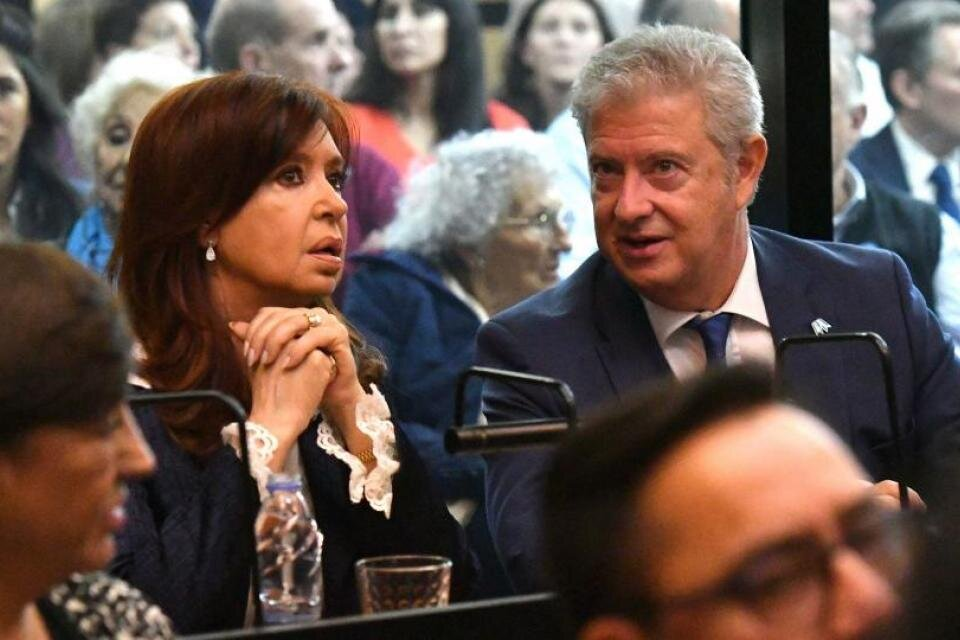

In [44]:
Image(imagen_req.content)

In [45]:
##Unificando El Scraper

def obtener_infos(soup_articulo):
        ret_dict={}
        
        ##Extraer Fecha
        fecha=soup_articulo.find('div',attrs={'class':'date modification-date'}).find('time')
        
        if fecha:
            ret_dict['fecha']=fecha.get('datetime')
        else:
            ret_dict['fecha']= None
        
        ##Extraer Titulo
        titulo=soup_articulo.find('div',attrs={'class':'col 2-col'}).find('h1')
        if titulo:
            ret_dict['titulo']=titulo.get_text()
        else:
            pass
            #ret_dict['titulo']=None
       
        ##Extraer copete
        copete=soup_articulo.find('div',attrs={'class':'col 2-col'}).find('h3')
        if copete:
            ret_dict['copete']=copete.get_text()
        else:
            ret_dict['copete']=None
        
        ##Extraer Volanta
        Volanta=soup_articulo.find('div',attrs={'class':'col 2-col'}).find('h4')
        if Volanta:
            ret_dict['Volanta']=Volanta.get_text()
        else:
            ret_dict['Volanta']=None
        
        ##Extraer Cuerpo 
        Cuerpo=soup_articulo.find('div',attrs={'class':'article-main-content article-text'})
        if Cuerpo:
            ret_dict['Cuerpo']=Cuerpo.get_text()
        else:
            ret_dict['Cuerpo']=None
        
        ##Extraer autor
        Autor=soup_articulo.find('div',attrs={'class':'author-name'})
        if Autor:
            ret_dict['Autor']=Autor.get_text()
        else:
            ret_dict['Autor']=None
            
        ##Extraer La Imagen
        Imagen = soup_articulo.find('div',attrs={'class':'image-wrapper'})
        Imagen_src=Imagen.find('img').get('src')
        imagen_req=requests.get(Imagen_src)
        imagen_req.status_code
        
        if imagen_req.status_code == 200:
            Imagen.find('img').get('src')
            ret_dict['imagen']=imagen_req.content  
        else:
            ret_dict['imagen']=None
            
        return ret_dict

In [46]:
def scrape_nota(url):
    try:
        articulo=requests.get(url)
    except Exception as e:
        print('Error scrapeando URL',url)
        print(e)
        return None
    if articulo.status_code!=200:
        print(f'Error Obteniendo nota{url}')
        return None
        
    soup_nota=BeautifulSoup(articulo.text,'html.parser')    
    ret_dict=obtener_infos(soup_nota)
    ret_dict['url']=url
    
    return ret_dict

In [47]:
scrape_nota(url_noticia_a_scrapear)

{'fecha': '2022-02-12T00:40:24-03:00',
 'titulo': 'Rechazan las recusaciones de CFK',
 'copete': '',
 'Volanta': 'El camarista Farah benefició a Llorens y Bertuzzi',
 'Cuerpo': 'No habrá cambios en la conformación de la Sala de la Cámara Federal que tiene que evaluar el futuro de una de las causas más importantes del espionaje durante el macrismo --la que indaga en las andanzas de los espías conocidos como Súper Mario Bros y en el espionaje penitenciario--. El camarista Eduardo Farah rechazó por "tardía" la recusación que la vicepresidenta Cristina Fernández de Kirchner había presentado contra sus colegas Mariano Llorens y Pablo Bertuzzi. Antes, Leopoldo Bruglia se negó a apartar a Farah, como reclamaba el exdirector general de la Agencia Federal de Inteligencia (AFI) Gustavo Arribas.El jueves, la Comisión Bicameral de Inteligencia denunció a Llorens y a Bertuzzi ante el Consejo de la Magistratura y pidió su remoción. Lo hizo después de que los dos camaristas --llegados al tribunal de 

In [48]:
links_secciones

['https://www.pagina12.com.ar/secciones/el-pais',
 'https://www.pagina12.com.ar/secciones/economia',
 'https://www.pagina12.com.ar/secciones/sociedad',
 'https://www.pagina12.com.ar/suplementos/cultura-y-espectaculos',
 'https://www.pagina12.com.ar/secciones/deportes',
 'https://www.pagina12.com.ar/secciones/el-mundo',
 'https://www.pagina12.com.ar/secciones/contratapa']

In [49]:
#armar una lista con cada una de las noticias que hay en una seccion
articulos_por_seccion=[]
i=0
for link in links_secciones:
    try:
        r=requests.get(link) 
        i=i+1
        if r.status_code==200 :
            soup=BeautifulSoup(r.text,'html.parser')
            articulos_por_seccion.extend(lista_de_links_utiles(obtener_links(soup)))
        else:
            print('No se pudo obtener la seccion')
            
    except:
        print('No se pudo obtener la seccion')

In [50]:
articulos_por_seccion

['https://www.pagina12.com.ar/401205-rechazan-las-recusaciones-de-cfk',
 'https://www.pagina12.com.ar/401181-gestapo-macrista-piden-la-ampliacion-de-la-imputacion-a-macr',
 'https://www.pagina12.com.ar/401206-la-gestapo-macrista-y-la-persecucion-a-jueces',
 'https://www.pagina12.com.ar/401180-los-intendentes-del-pro-tambien-piden-apoyar-el-acuerdo-con-',
 'https://www.pagina12.com.ar/401182-juicio-politico',
 'https://www.pagina12.com.ar/401183-gobernadores-del-norte-manifestaron-su-apoyo-al-traspaso-de-',
 'https://www.pagina12.com.ar/401184-colectivos-portenos-a-rodriguez-larreta-lo-dejaron-solo',
 'https://www.pagina12.com.ar/401189-alberto-fernandez-queremos-poner-en-valor-el-aporte-de-la-mu',
 'https://www.pagina12.com.ar/401190-la-cidh-rechazo-pedidos-de-impugnacion-de-cinco-represores',
 'https://www.pagina12.com.ar/401196-el-gobierno-lanza-un-instructivo-para-fomentar-la-equidad-de',
 'https://www.pagina12.com.ar/401204-continua-la-busqueda-de-consensos',
 'https://www.pagina12

In [51]:
data=[]
i=0
for articulo in articulos_por_seccion:
    i=i+1
    print(f'scrapeando articulo{i}/{len(articulos_por_seccion)}')
    data.append(scrape_nota(articulo))

scrapeando articulo1/66
scrapeando articulo2/66
scrapeando articulo3/66
scrapeando articulo4/66
scrapeando articulo5/66
scrapeando articulo6/66
scrapeando articulo7/66
scrapeando articulo8/66
scrapeando articulo9/66
scrapeando articulo10/66
scrapeando articulo11/66
scrapeando articulo12/66
scrapeando articulo13/66
scrapeando articulo14/66
scrapeando articulo15/66
scrapeando articulo16/66
scrapeando articulo17/66
scrapeando articulo18/66
scrapeando articulo19/66
scrapeando articulo20/66
scrapeando articulo21/66
scrapeando articulo22/66
scrapeando articulo23/66
scrapeando articulo24/66
scrapeando articulo25/66
scrapeando articulo26/66
scrapeando articulo27/66
scrapeando articulo28/66
scrapeando articulo29/66
scrapeando articulo30/66
scrapeando articulo31/66
scrapeando articulo32/66
scrapeando articulo33/66
scrapeando articulo34/66
scrapeando articulo35/66
scrapeando articulo36/66
scrapeando articulo37/66
scrapeando articulo38/66
scrapeando articulo39/66
scrapeando articulo40/66
scrapeand

In [52]:
len(data)

66

In [53]:
data

[{'fecha': '2022-02-12T00:40:24-03:00',
  'titulo': 'Rechazan las recusaciones de CFK',
  'copete': '',
  'Volanta': 'El camarista Farah benefició a Llorens y Bertuzzi',
  'Cuerpo': 'No habrá cambios en la conformación de la Sala de la Cámara Federal que tiene que evaluar el futuro de una de las causas más importantes del espionaje durante el macrismo --la que indaga en las andanzas de los espías conocidos como Súper Mario Bros y en el espionaje penitenciario--. El camarista Eduardo Farah rechazó por "tardía" la recusación que la vicepresidenta Cristina Fernández de Kirchner había presentado contra sus colegas Mariano Llorens y Pablo Bertuzzi. Antes, Leopoldo Bruglia se negó a apartar a Farah, como reclamaba el exdirector general de la Agencia Federal de Inteligencia (AFI) Gustavo Arribas.El jueves, la Comisión Bicameral de Inteligencia denunció a Llorens y a Bertuzzi ante el Consejo de la Magistratura y pidió su remoción. Lo hizo después de que los dos camaristas --llegados al tribuna

In [54]:
df=pd.DataFrame(data)

In [55]:
df.head(5)

,fecha,titulo,copete,Volanta,Cuerpo,Autor,imagen,url
0,2022-02-12T00:40:24-03:00,Rechazan las recusaciones de CFK,,El camarista Farah benefició a Llorens y Bertuzzi,No habrá cambios en la conformación de la Sala...,None,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...,https://www.pagina12.com.ar/401205-rechazan-la...
1,2022-02-12T00:40:23-03:00,"""Gestapo"" macrista: Piden la ampliación de la ...",,"La persecución contra Medina, el dirigente de ...",El sindicalista de la UOCRA Juan Pablo “Pata” ...,None,b'\xff\xd8\xff\xe1\x00eExif\x00\x00II*\x00\x08...,https://www.pagina12.com.ar/401181-gestapo-mac...
2,2022-02-12T00:41:40-03:00,"La ""Gestapo"" macrista y la persecución a jueces",La historia del camarista federal de Mar del P...,El gobierno de Macri y el uso de datos privado...,"Corría el año 2018, pleno gobierno de Cambiemo...",Por Irina Hauser,"b'\xff\xd8\xff\xe1\x00""Exif\x00\x00II*\x00\x08...",https://www.pagina12.com.ar/401206-la-gestapo-...
3,2022-02-12T00:40:27-03:00,Los intendentes del PRO también piden apoyar e...,,En línea con la mesa nacional de JxC los jefes...,Un día después de la cumbre de la mesa naciona...,None,"b'\xff\xd8\xff\xe1\x00""Exif\x00\x00MM\x00*\x00...",https://www.pagina12.com.ar/401180-los-intende...
4,2022-02-12T00:40:26-03:00,Juicio Político,,,La ausencia de los consejeros macristas y de l...,Por Luis Bruschtein,"b'\xff\xd8\xff\xe1\x00""Exif\x00\x00MM\x00*\x00...",https://www.pagina12.com.ar/401182-juicio-poli...


In [56]:
#guardando el dataframe en un archivo csv
df.to_csv('Noticias Pagina12.csv')